# Module 2 - Proyect 

![Image](https://images.unsplash.com/photo-1520611084738-c4ad1e2e1903?ixlib=rb-1.2.1&auto=format&fit=crop&crop=entropy&w=1620&h=500&q=80)  



The aim of this proyect is analyze a given Diamonds dataset. We were looking for insights that determinates the influence of each variable into the final diamond price. 

---

## Index
- **Libraries used**
- **Dataset Exploration**
    - Shape
    - Data types and null values
- **Basic Statistics of diamons' dataframe**
- **Diamons' dataframe operations**
    - Missing Data
    - Weird data
    - Duplicated data
- **Analysis by type of data**
    - Quantitative data
        - Cut
        - Color 
        - Clarity
    - Qualitative data
        - Carat
        - Price
        - Table
        - Depth
        - Size (x,y,z)
- **How previous columns are performing together**    
    - Correlation
    - Contingency table
    - Cramer's V
    - Custom Rapaport table
- **Conclusions**
- **Export data filtered**

---

## **Libreries used**

Keep in mind that those libraries have to be installed in your enviroment

In [1]:
#data libraries
import numpy as np
import pandas as pd

#visualization libraries
import matplotlib.pyplot as plt
import seaborn as sns
import cufflinks as cf
import plotly.express as px
import warnings
from IPython.display import set_matplotlib_formats
cf.go_offline()

In [2]:
warnings.filterwarnings('ignore')
%matplotlib inline

**Load Diamonds' Dataset with pandas**

In [3]:
diamonds_raw =  pd.read_csv('../data/raw/diamonds_train.csv')

## **Dataset Exploration**

### Shape

In [4]:
diamonds_raw

,carat,cut,color,clarity,depth,table,price,x,y,z
0,1.21,Premium,J,VS2,62.4,58.0,4268,6.83,6.79,4.25
1,0.32,Very Good,H,VS2,63.0,57.0,505,4.35,4.38,2.75
2,0.71,Fair,G,VS1,65.5,55.0,2686,5.62,5.53,3.65
3,0.41,Good,D,SI1,63.8,56.0,738,4.68,4.72,3.00
4,1.02,Ideal,G,SI1,60.5,59.0,4882,6.55,6.51,3.95
...,...,...,...,...,...,...,...,...,...,...
40450,1.34,Ideal,G,VS1,62.7,57.0,10070,7.10,7.04,4.43
40451,2.02,Good,F,SI2,57.1,60.0,12615,8.31,8.25,4.73
40452,1.01,Ideal,H,SI1,62.7,56.0,5457,6.37,6.42,4.01
40453,0.33,Ideal,J,VS1,61.9,54.3,456,4.45,4.47,2.76


In [5]:
print(f'*Our dataset has {len(diamonds_raw.index)} rows and {len(diamonds_raw.columns)} columns*')

*Our dataset has 40455 rows and 10 columns*


### Data types and null values

In [6]:
print(f'The dataset has those null values: \n{diamonds_raw.isnull().sum()} null values')

The dataset has those null values: 
carat      0
cut        0
color      0
clarity    0
depth      0
table      0
price      0
x          0
y          0
z          0
dtype: int64 null values


In [7]:
numerical_cols = diamonds_raw.select_dtypes(include=['int','float']).columns.to_list()
object_cols =diamonds_raw.select_dtypes(include=['object']).columns.to_list()
f'Dataset has these numerical cols:{numerical_cols} and these object cols:{object_cols}'

"Dataset has these numerical cols:['carat', 'depth', 'table', 'price', 'x', 'y', 'z'] and these object cols:['cut', 'color', 'clarity']"

In [8]:
diamonds_raw.info(memory_usage='deep')

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40455 entries, 0 to 40454
Data columns (total 10 columns):
 #   Column   Non-Null Count  Dtype  
---  ------   --------------  -----  
 0   carat    40455 non-null  float64
 1   cut      40455 non-null  object 
 2   color    40455 non-null  object 
 3   clarity  40455 non-null  object 
 4   depth    40455 non-null  float64
 5   table    40455 non-null  float64
 6   price    40455 non-null  int64  
 7   x        40455 non-null  float64
 8   y        40455 non-null  float64
 9   z        40455 non-null  float64
dtypes: float64(6), int64(1), object(3)
memory usage: 9.5 MB


## **Basic Statistics of diamons' dataframe**

In [9]:
diamonds_raw.describe(include='all')

,carat,cut,color,clarity,depth,table,price,x,y,z
count,40455.000000,40455,40455,40455,40455.000000,40455.000000,40455.000000,40455.000000,40455.000000,40455.000000
unique,NaN,5,7,8,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,Ideal,G,SI1,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,16220,8455,9749,NaN,NaN,NaN,NaN,NaN,NaN
mean,0.797706,NaN,NaN,NaN,61.752841,57.446133,3928.444469,5.729392,5.732819,3.537154
std,0.475544,NaN,NaN,NaN,1.431725,2.233535,3992.416147,1.124453,1.146650,0.697062
min,0.200000,NaN,NaN,NaN,43.000000,43.000000,326.000000,0.000000,0.000000,0.000000
25%,0.400000,NaN,NaN,NaN,61.000000,56.000000,945.000000,4.710000,4.720000,2.910000
50%,0.700000,NaN,NaN,NaN,61.800000,57.000000,2397.000000,5.690000,5.710000,3.520000
75%,1.040000,NaN,NaN,NaN,62.500000,59.000000,5331.000000,6.540000,6.540000,4.035000


## **Diamons' dataframe operations**

###  Missing data

We missed price per carat, an important measure that could give us an idea about a diamonds with similar characteristics, but different weight. 
If we will have a diamond with same carat weight, we could go deeper to estimate the price with other Cs of the diamonds. 
It also will provide as with a range of values for "similar" diamonds.

Add price per carat column

In [10]:
diamonds_raw['price_per_carat'] = diamonds_raw['price']/diamonds_raw['carat']

In [11]:
diamonds_raw

,carat,cut,color,clarity,depth,table,price,x,y,z,price_per_carat
0,1.21,Premium,J,VS2,62.4,58.0,4268,6.83,6.79,4.25,3527.272727
1,0.32,Very Good,H,VS2,63.0,57.0,505,4.35,4.38,2.75,1578.125000
2,0.71,Fair,G,VS1,65.5,55.0,2686,5.62,5.53,3.65,3783.098592
3,0.41,Good,D,SI1,63.8,56.0,738,4.68,4.72,3.00,1800.000000
4,1.02,Ideal,G,SI1,60.5,59.0,4882,6.55,6.51,3.95,4786.274510
...,...,...,...,...,...,...,...,...,...,...,...
40450,1.34,Ideal,G,VS1,62.7,57.0,10070,7.10,7.04,4.43,7514.925373
40451,2.02,Good,F,SI2,57.1,60.0,12615,8.31,8.25,4.73,6245.049505
40452,1.01,Ideal,H,SI1,62.7,56.0,5457,6.37,6.42,4.01,5402.970297
40453,0.33,Ideal,J,VS1,61.9,54.3,456,4.45,4.47,2.76,1381.818182


### Check weird data observed in the basic statistics

It doesn't make sense that the min of x, y or z is 0. They are size values, so it can not be 0. We will delete them.

In [12]:
size_ceros = (diamonds_raw['x']==0) | (diamonds_raw['z']==0) | (diamonds_raw['y']==0) 
diamonds_raw.loc[size_ceros,:]


,carat,cut,color,clarity,depth,table,price,x,y,z,price_per_carat
1606,1.01,Premium,F,SI2,59.2,58.0,3837,6.50,6.47,0.0,3799.009901
3945,2.02,Premium,H,VS2,62.7,53.0,18207,8.02,7.95,0.0,9013.366337
6465,0.71,Good,F,SI2,64.1,60.0,2130,0.00,0.00,0.0,3000.000000
13839,2.80,Good,G,SI2,63.8,58.0,18788,8.90,8.85,0.0,6710.000000
14815,1.07,Ideal,F,SI2,61.6,56.0,4954,0.00,6.62,0.0,4629.906542
14891,2.18,Premium,H,SI2,59.4,61.0,12631,8.49,8.45,0.0,5794.036697
16425,2.20,Premium,H,SI1,61.2,59.0,17265,8.42,8.37,0.0,7847.727273
19856,1.00,Premium,G,SI2,59.1,59.0,3142,6.55,6.48,0.0,3142.000000
21602,1.15,Ideal,G,VS2,59.2,56.0,5564,6.88,6.83,0.0,4838.260870
24795,1.10,Premium,G,SI2,63.0,59.0,3696,6.50,6.47,0.0,3360.000000


In [13]:
print(f'There are {len(diamonds_raw.loc[size_ceros,:])} rows with value 0 in one of their size measure')

There are 16 rows with value 0 in one of their size measure


In [14]:
diamonds_no_ceros = diamonds_raw.drop(diamonds_raw.loc[size_ceros,:].index, axis=0, inplace=False)
diamonds_no_ceros

,carat,cut,color,clarity,depth,table,price,x,y,z,price_per_carat
0,1.21,Premium,J,VS2,62.4,58.0,4268,6.83,6.79,4.25,3527.272727
1,0.32,Very Good,H,VS2,63.0,57.0,505,4.35,4.38,2.75,1578.125000
2,0.71,Fair,G,VS1,65.5,55.0,2686,5.62,5.53,3.65,3783.098592
3,0.41,Good,D,SI1,63.8,56.0,738,4.68,4.72,3.00,1800.000000
4,1.02,Ideal,G,SI1,60.5,59.0,4882,6.55,6.51,3.95,4786.274510
...,...,...,...,...,...,...,...,...,...,...,...
40450,1.34,Ideal,G,VS1,62.7,57.0,10070,7.10,7.04,4.43,7514.925373
40451,2.02,Good,F,SI2,57.1,60.0,12615,8.31,8.25,4.73,6245.049505
40452,1.01,Ideal,H,SI1,62.7,56.0,5457,6.37,6.42,4.01,5402.970297
40453,0.33,Ideal,J,VS1,61.9,54.3,456,4.45,4.47,2.76,1381.818182


### Check duplicated data

In [15]:
diamonds_duplicated_filter = diamonds_no_ceros[diamonds_no_ceros.duplicated(keep='first')]
diamonds_duplicated_filter.sort_values(by="cut", ascending=True)

,carat,cut,color,clarity,depth,table,price,x,y,z,price_per_carat
33684,1.00,Fair,E,SI2,67.0,53.0,3136,6.19,6.13,4.13,3136.000000
3083,1.00,Fair,H,SI1,65.5,57.0,3511,6.26,6.21,4.08,3511.000000
18637,2.01,Fair,G,SI2,65.9,57.0,10887,7.85,7.78,5.15,5416.417910
16833,2.50,Fair,H,SI2,64.9,58.0,13278,8.46,8.43,5.48,5311.200000
20676,2.66,Good,H,SI2,63.8,57.0,16239,8.71,8.65,5.54,6104.887218
...,...,...,...,...,...,...,...,...,...,...,...
15771,0.40,Very Good,D,SI1,63.0,57.0,720,4.66,4.70,2.95,1800.000000
30959,1.55,Very Good,H,SI1,63.2,57.0,7066,7.35,7.31,4.64,4558.709677
6439,2.01,Very Good,H,SI2,63.4,60.0,11780,7.97,7.89,5.03,5860.696517
5631,0.30,Very Good,G,VS2,63.0,55.0,526,4.29,4.31,2.71,1753.333333


In [16]:
diamonds = diamonds_no_ceros.drop(diamonds_duplicated_filter.index, axis=0, inplace=False)
diamonds

,carat,cut,color,clarity,depth,table,price,x,y,z,price_per_carat
0,1.21,Premium,J,VS2,62.4,58.0,4268,6.83,6.79,4.25,3527.272727
1,0.32,Very Good,H,VS2,63.0,57.0,505,4.35,4.38,2.75,1578.125000
2,0.71,Fair,G,VS1,65.5,55.0,2686,5.62,5.53,3.65,3783.098592
3,0.41,Good,D,SI1,63.8,56.0,738,4.68,4.72,3.00,1800.000000
4,1.02,Ideal,G,SI1,60.5,59.0,4882,6.55,6.51,3.95,4786.274510
...,...,...,...,...,...,...,...,...,...,...,...
40450,1.34,Ideal,G,VS1,62.7,57.0,10070,7.10,7.04,4.43,7514.925373
40451,2.02,Good,F,SI2,57.1,60.0,12615,8.31,8.25,4.73,6245.049505
40452,1.01,Ideal,H,SI1,62.7,56.0,5457,6.37,6.42,4.01,5402.970297
40453,0.33,Ideal,J,VS1,61.9,54.3,456,4.45,4.47,2.76,1381.818182


In [17]:
diamonds.describe(include='all')

,carat,cut,color,clarity,depth,table,price,x,y,z,price_per_carat
count,40351.000000,40351,40351,40351,40351.000000,40351.000000,40351.000000,40351.000000,40351.000000,40351.000000,40351.000000
unique,NaN,5,7,8,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,Ideal,G,SI1,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,16177,8427,9729,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,0.797335,NaN,NaN,NaN,61.752405,57.446688,3927.334738,5.729696,5.733031,3.538584,4003.591277
std,0.474748,NaN,NaN,NaN,1.430913,2.233355,3989.473870,1.121695,1.144435,0.693198,2010.535770
min,0.200000,NaN,NaN,NaN,43.000000,43.000000,326.000000,3.770000,3.720000,1.070000,1051.162791
25%,0.400000,NaN,NaN,NaN,61.000000,56.000000,945.000000,4.710000,4.720000,2.910000,2471.399364
50%,0.700000,NaN,NaN,NaN,61.800000,57.000000,2398.000000,5.690000,5.710000,3.520000,3492.500000
75%,1.040000,NaN,NaN,NaN,62.500000,59.000000,5330.000000,6.540000,6.540000,4.035000,4949.176471


## **Analysis by type of column**

### **Quantitative data**

#### **Cut** 
- The “cut” of a diamond which refers to both its cut shape and its cut quality.
- In order to calculate the price of a diamond, we need to know its cut shape.
- While it is easy to determine the cut shape of a diamond, it is not so easy to determine if this diamond has the right dimensions, is well-proportioned: if it has a good cut quality.

##### **Basic statistics**

In [18]:
diamonds['cut'].unique()

array(['Premium', 'Very Good', 'Fair', 'Good', 'Ideal'], dtype=object)

In [19]:
diamonds['cut'].describe()

count     40351
unique        5
top       Ideal
freq      16177
Name: cut, dtype: object

In [20]:
order_dict = {'Ideal': 0, 'Premium': 1, 'Very Good': 2, 'Good': 3,'Fair':4}
d_cut_ordered = diamonds.iloc[diamonds['cut'].map(order_dict).argsort()]

In [21]:
cut_mean = d_cut_ordered.groupby('cut')['cut'].count()
cut_dict = cut_mean.to_dict()
cut_dict

{'Fair': 1212,
 'Good': 3649,
 'Ideal': 16177,
 'Premium': 10223,
 'Very Good': 9090}

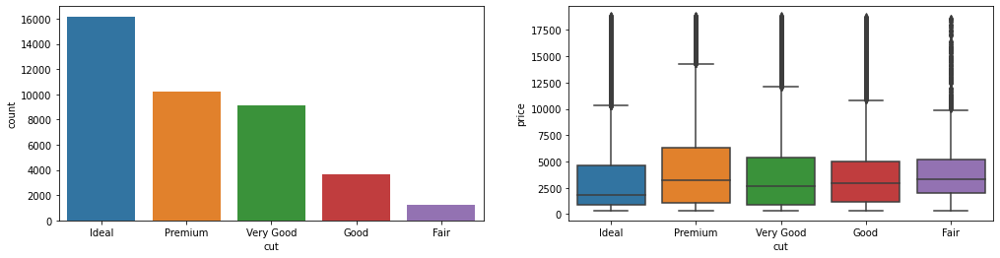

In [22]:
fig, ax = plt.subplots(1,2,figsize=(17,4))
sns.countplot(x='cut', data = d_cut_ordered,ax=ax[0])
sns.boxplot(x="cut", y="price", data=d_cut_ordered, ax=ax[1]);
plt.show()

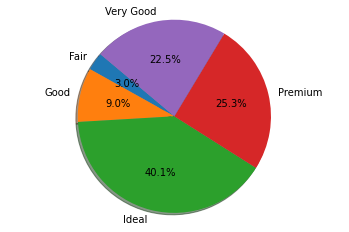

In [23]:
cut_proportion = diamonds.groupby('cut').size().reset_index()
# Data to plot
labels = cut_proportion['cut']
sizes = cut_proportion[0]

# Plot
plt.pie(sizes,labels=labels,
autopct='%1.1f%%', shadow=True, startangle=140)

plt.axis('equal')
plt.show()

#### **Color** 

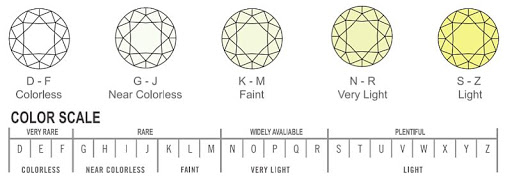

The color has a great effect on the value of diamonds and diamond experts have created a color grade scale starting at the letter D right through to the letter Z. Therefore, the further down the scale you go, the lower the value of the diamond.

##### **Basic statistics**

In [24]:
diamonds['color'].unique()

array(['J', 'H', 'G', 'D', 'F', 'E', 'I'], dtype=object)

In [25]:
diamonds['color'].describe()

count     40351
unique        7
top           G
freq       8427
Name: color, dtype: object

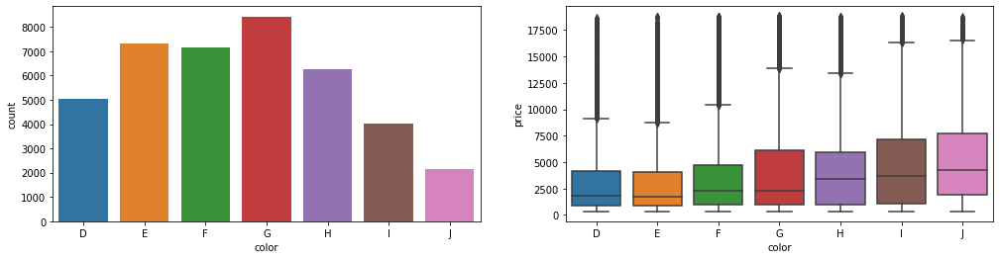

In [26]:
fig, ax = plt.subplots(1,2,figsize=(17,4))
sns.countplot(x='color', data = diamonds.sort_values(by="color"),ax=ax[0])
sns.boxplot(x="color", y="price", data=diamonds.sort_values(by="color"), ax=ax[1]);
plt.show()

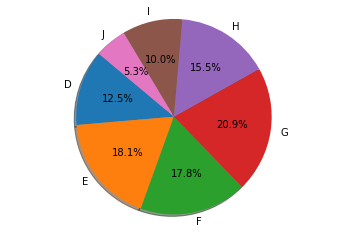

In [27]:
color_proportion = diamonds.groupby('color').size().reset_index()

# Data to plot
labels = color_proportion['color']
sizes = color_proportion[0]

# Plot
plt.pie(sizes,labels=labels,
autopct='%1.1f%%', shadow=True, startangle=140)

plt.axis('equal')
plt.show()

#### **Clarity** 

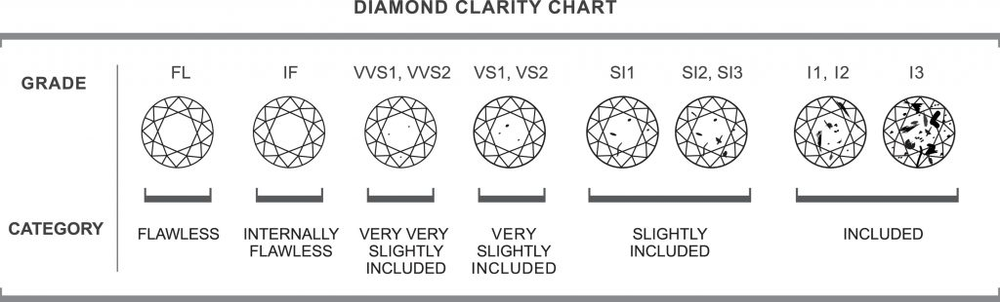

A magnifying glass with 10 times magnification (10x lens) is used in order to see the inclusions (natural blemishes) present in the diamond. An expert certified in gemmology looks at the diamond under the 10x magnifying glass in order to count and position the inclusions present in the diamond. The more inclusions a diamond has, the lower its value. The most ought-after diamonds are those whose inclusions cannot be seen at ten times magnification: these are Flawless (FL) and Internally Flawless (IF) diamonds. Conversely, P1, P2 and P3 diamonds are the least valued as their inclusions are visible to the human eye.

##### **Basic statistics**

In [28]:
diamonds['clarity'].unique()

array(['VS2', 'VS1', 'SI1', 'SI2', 'IF', 'VVS1', 'VVS2', 'I1'],
      dtype=object)

In [29]:
diamonds['clarity'].describe()

count     40351
unique        8
top         SI1
freq       9729
Name: clarity, dtype: object

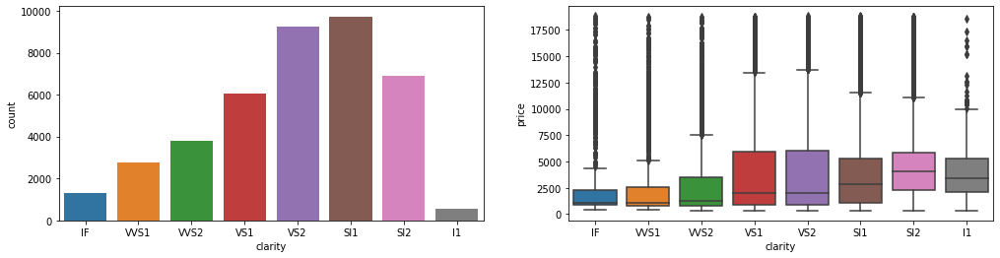

In [30]:
order_dict = {'IF': 0, 'VVS1': 1, 'VVS2': 2, 'VS1': 3,'VS2':4,'SI1':5,'SI2':6,'I1':7}
d_clarity_orderded = diamonds.iloc[diamonds['clarity'].map(order_dict).argsort()]

fig, ax = plt.subplots(1,2,figsize=(17,4))
sns.countplot(x='clarity', data = d_clarity_orderded,ax=ax[0])
sns.boxplot(x="clarity", y="price", data=d_clarity_orderded, ax=ax[1]);
plt.show()

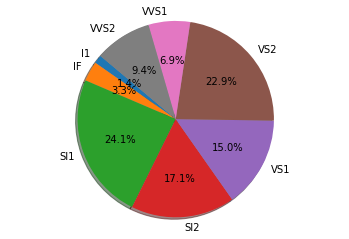

In [31]:
clarity_proportion = diamonds.groupby('clarity').size().reset_index()

# Data to plot
labels = clarity_proportion['clarity']
sizes = clarity_proportion[0]
# colors = ['gold', 'yellowgreen', 'lightcoral', 'lightskyblue']


# Plot
plt.pie(sizes,labels=labels,
autopct='%1.1f%%', shadow=True, startangle=140)

plt.axis('equal')
plt.show()

### **Qualitative data**

#### **Carat** 
- A unit of measurement used to weigh diamonds.
- 1 carat is equal to 200 miligrams.
- An increase in carat weight will mean an increase in depth as well as diameter.
- The larger a diamond is, the more rare it is. This means that the price per carat increases exponentially when comparing diamonds of the same quality.

##### **Basic statistics**

In [32]:
diamonds['carat'].describe()

count    40351.000000
mean         0.797335
std          0.474748
min          0.200000
25%          0.400000
50%          0.700000
75%          1.040000
max          4.500000
Name: carat, dtype: float64

In [33]:
mode = diamonds['carat'].mode()
print(f'The mode of carat is{mode}')

The mode of carat is0    0.3
dtype: float64


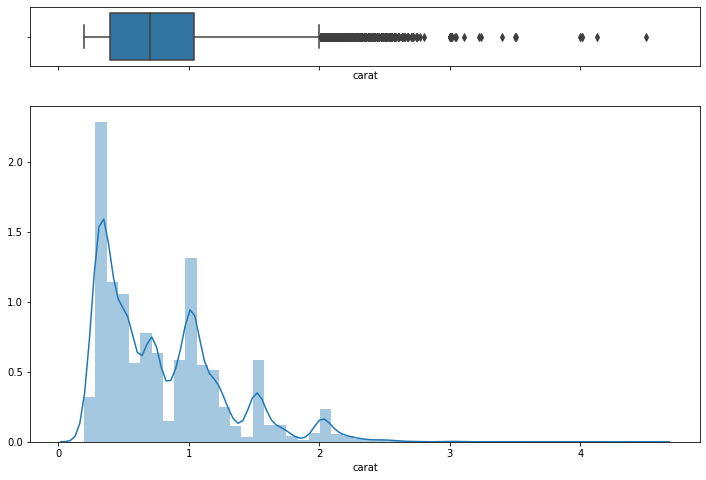

In [34]:
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.15, .85)}, figsize=(12,8))
sns.boxplot(diamonds['carat'], ax=ax_box)
sns.distplot(diamonds['carat'], ax=ax_hist)

##### **How carat influence on price**

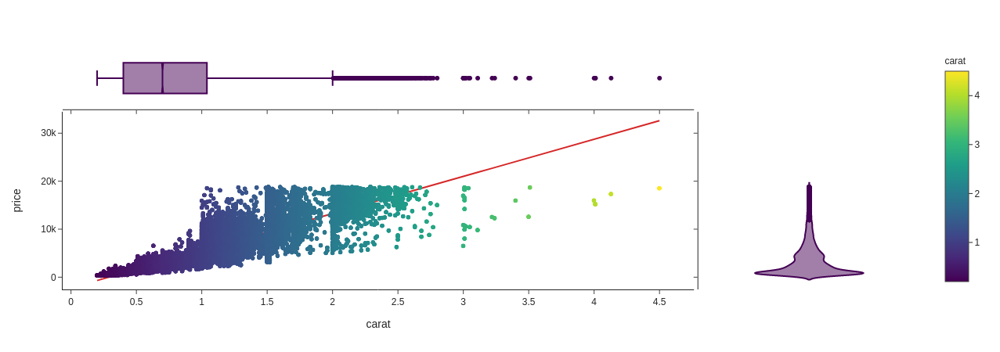

In [35]:
fig = px.scatter(diamonds, x="carat", y="price", color="carat", marginal_y="violin",marginal_x="box", trendline="ols", template="simple_white")
fig.show()

#### **Price** 




##### **Basic statistics**

In [36]:
diamonds['price'].describe()

count    40351.000000
mean      3927.334738
std       3989.473870
min        326.000000
25%        945.000000
50%       2398.000000
75%       5330.000000
max      18823.000000
Name: price, dtype: float64

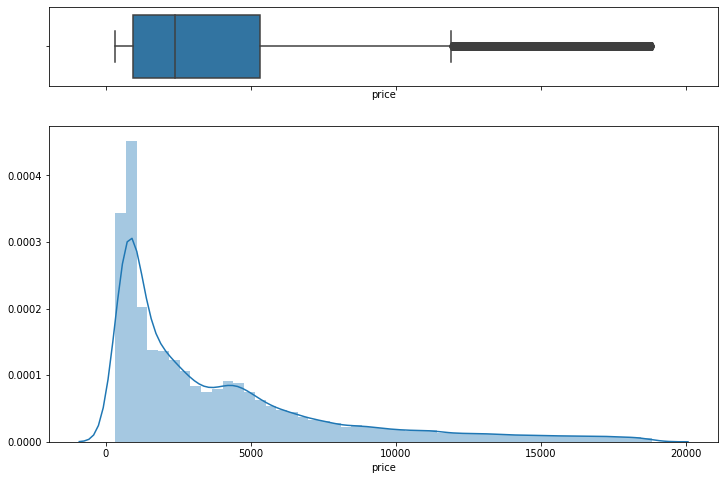

In [37]:
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.20, .80)}, figsize=(12,8))
sns.boxplot(diamonds['price'], ax=ax_box)
sns.distplot(diamonds['price'], ax=ax_hist)

#### **Price** 


##### **Basic statistics**

In [38]:
diamonds['price_per_carat'].describe()

count    40351.000000
mean      4003.591277
std       2010.535770
min       1051.162791
25%       2471.399364
50%       3492.500000
75%       4949.176471
max      17828.846154
Name: price_per_carat, dtype: float64

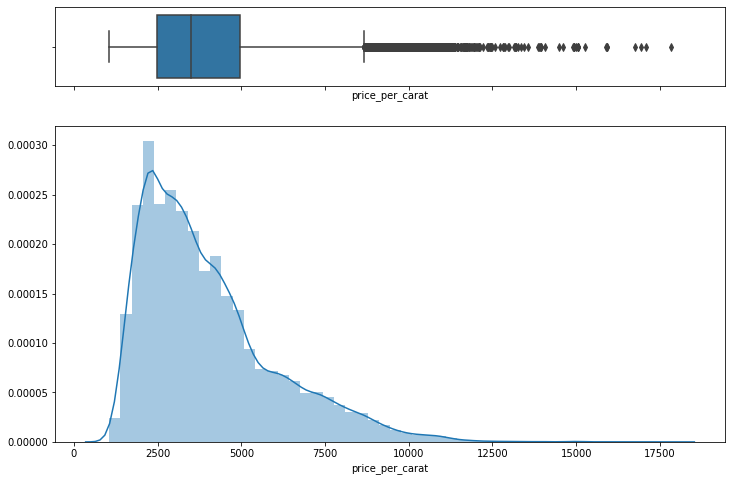

In [39]:
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.20, .80)}, figsize=(12,8))
sns.boxplot(diamonds['price_per_carat'], ax=ax_box)
sns.distplot(diamonds['price_per_carat'], ax=ax_hist)

#### **Depth** 

##### **Basic statistics**
For analyzing Depth, we have to keep in mind that depth is z/mean(y,x).
The depth of a diamond might also be called the “height”: it is the distance from the table to the culet (the pointed tip) of the diamond.

In [40]:
diamonds['depth'].describe()

count    40351.000000
mean        61.752405
std          1.430913
min         43.000000
25%         61.000000
50%         61.800000
75%         62.500000
max         79.000000
Name: depth, dtype: float64

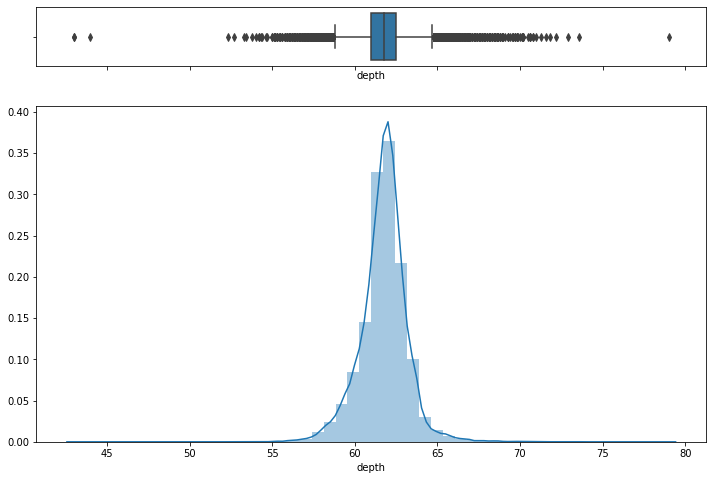

In [41]:
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.15, .85)}, figsize=(12,8))
sns.boxplot(diamonds['depth'], ax=ax_box)
sns.distplot(diamonds['depth'], ax=ax_hist)

##### **How depth influence on price**

We observed that data trends to a normal distribution where a well proportion diamonds is more expensive than a bigger one. Also, with a well proportion one, carat influence on it's price

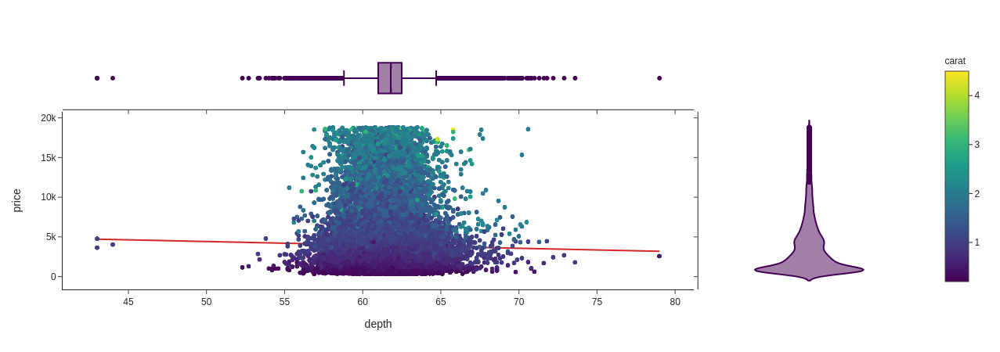

In [42]:
fig = px.scatter(diamonds, x="depth", y="price", color="carat", marginal_y="violin",marginal_x="box", trendline="ols", template="simple_white")
fig.show()

#### **Table** 

##### **Basic statistics**
Table percentage is calculated by dividing the width of the table by the overall width of the diamond.

In [43]:
diamonds['table'].describe()

count    40351.000000
mean        57.446688
std          2.233355
min         43.000000
25%         56.000000
50%         57.000000
75%         59.000000
max         95.000000
Name: table, dtype: float64

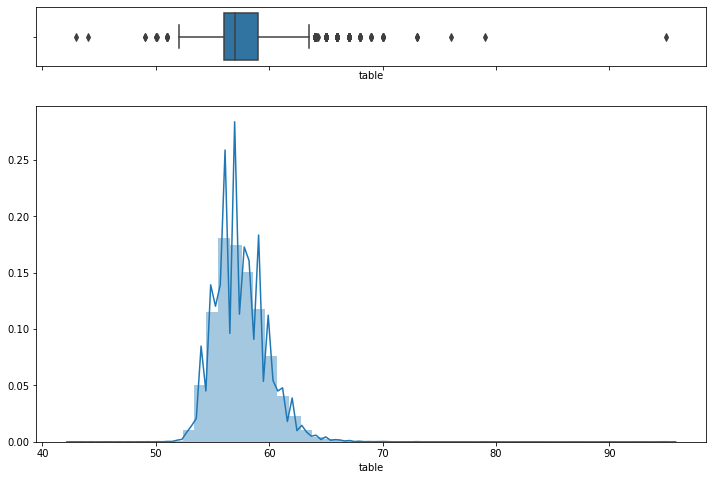

In [44]:
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.15, .85)}, figsize=(12,8))
sns.boxplot(diamonds['table'], ax=ax_box)
sns.distplot(diamonds['table'], ax=ax_hist)

##### **How depth influence on price**

With the plot below we can not conclude that te more talbe the more price. 

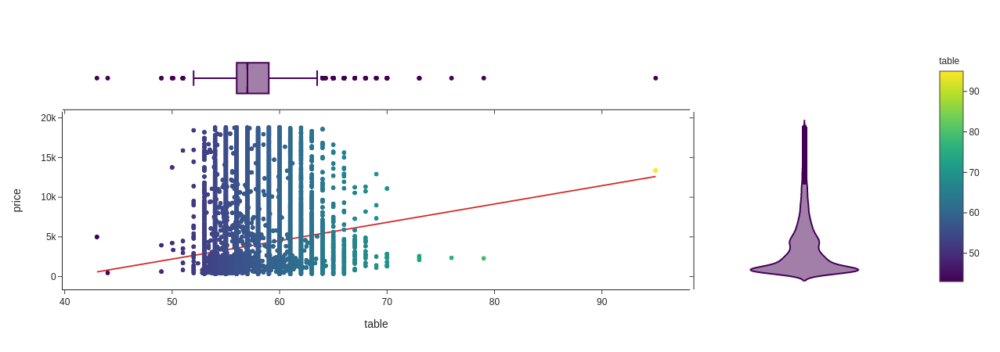

In [45]:
fig = px.scatter(diamonds, x="table", y="price" , color="table",marginal_y="violin",marginal_x="box", trendline="ols", template="simple_white")
fig.show()

#### **X,Y,Z** 

##### **Basic statistics**


In [46]:
diamonds[['x','y','z']].describe()

,x,y,z
count,40351.000000,40351.000000,40351.000000
mean,5.729696,5.733031,3.538584
std,1.121695,1.144435,0.693198
min,3.770000,3.720000,1.070000
25%,4.710000,4.720000,2.910000
50%,5.690000,5.710000,3.520000
75%,6.540000,6.540000,4.035000
max,10.230000,58.900000,8.060000


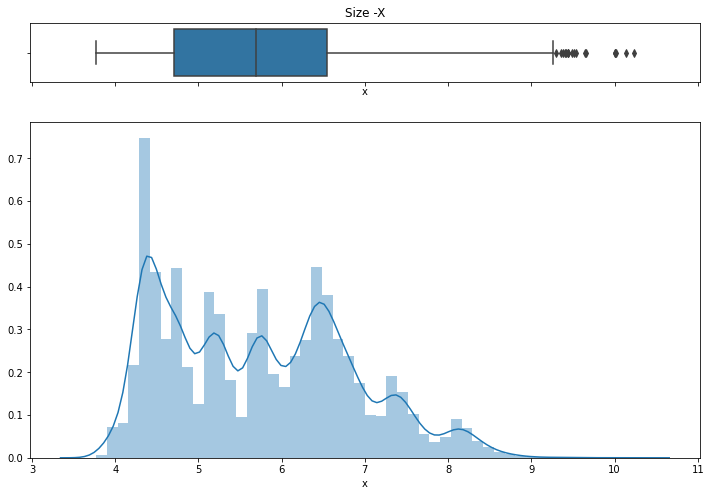

In [47]:
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.15, .85)}, figsize=(12,8))
sns.boxplot(diamonds['x'], ax=ax_box).set_title("Size -X")
sns.distplot(diamonds['x'], ax=ax_hist)

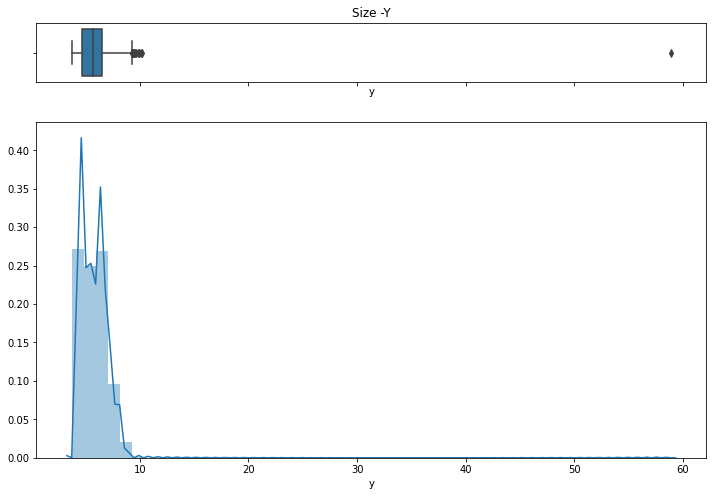

In [48]:
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.15, .85)}, figsize=(12,8))
sns.boxplot(diamonds['y'], ax=ax_box).set_title("Size -Y")
sns.distplot(diamonds['y'], ax=ax_hist)

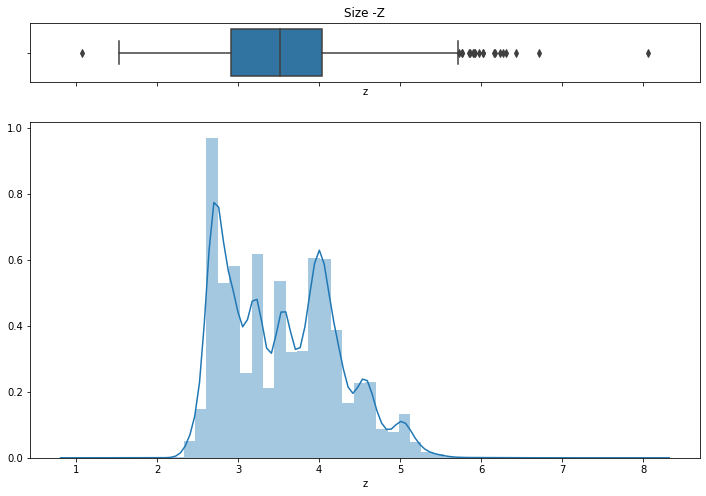

In [49]:
f, (ax_box, ax_hist) = plt.subplots(2, sharex=True, gridspec_kw={"height_ratios": (.15, .85)}, figsize=(12,8))
sns.boxplot(diamonds['z'], ax=ax_box).set_title("Size -Z")
sns.distplot(diamonds['z'], ax=ax_hist)

##### **How x,y,z influence on price**

It seems to be a relation between size and prize. These plots seems follow a logarithmic trend, where the more x or z or y, the more price

Text(0.5, 1.0, 'Price / Z')

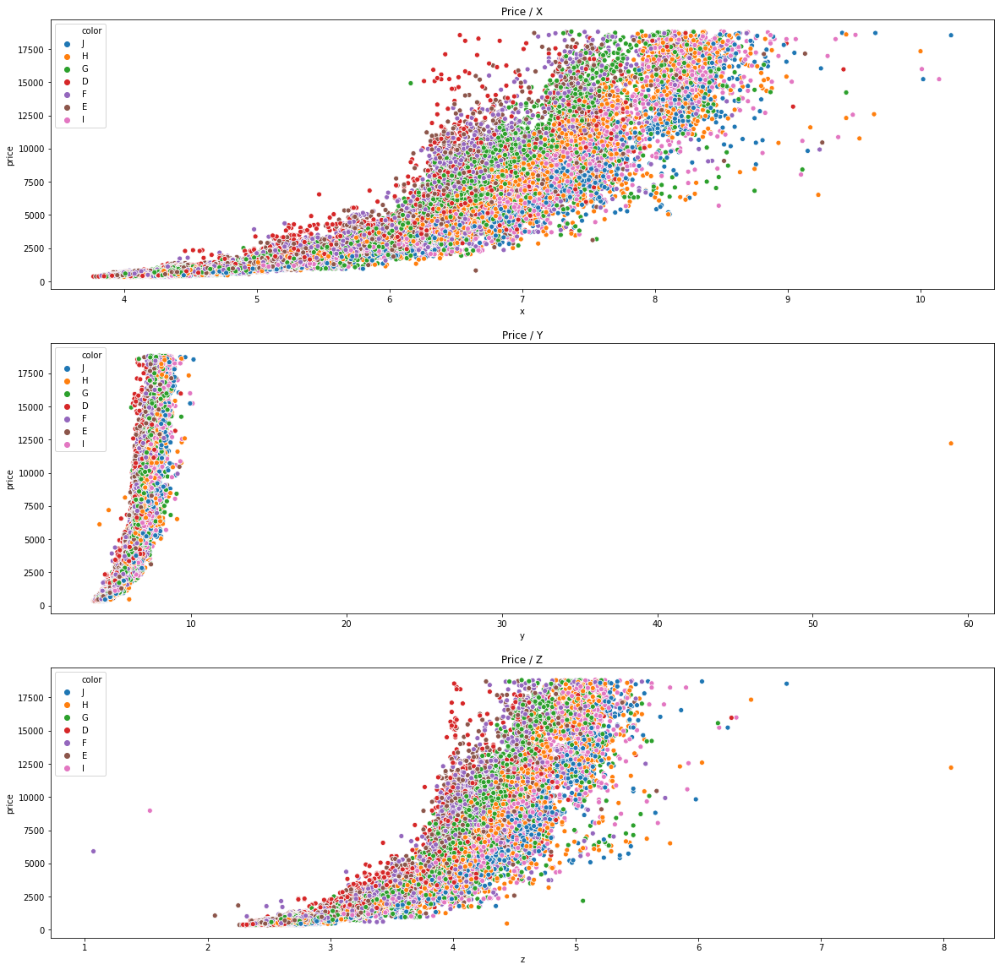

In [50]:
fig, ax = plt.subplots(nrows = 3, ncols = 1, figsize = (20, 20))
sns.scatterplot(x = 'x', y = 'price', hue = 'color', data = diamonds, ax = ax[0]).set_title("Price / X")
sns.scatterplot(x = 'y', y = 'price', hue = 'color', data = diamonds, ax = ax[1]).set_title("Price / Y")
# ax[1].set_xlim([0, 15])
sns.scatterplot(x = 'z', y = 'price', hue = 'color', data = diamonds, ax = ax[2]).set_title("Price / Z")

## How depth and table affects to cut

From the graphic above, we can see that the more proportion between table and depth, the more price. 

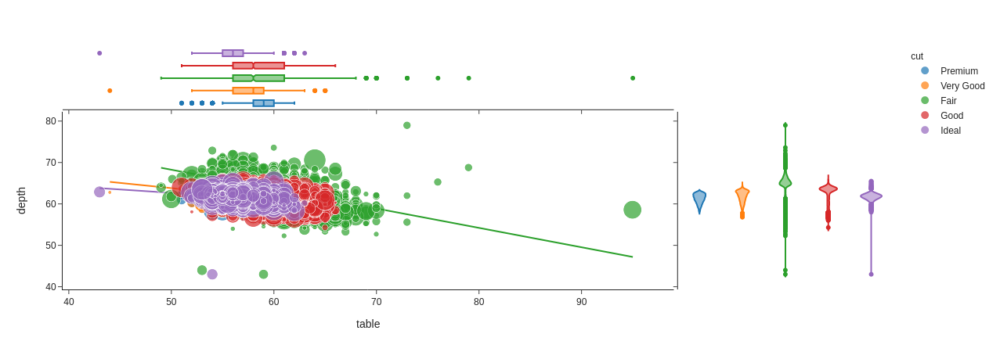

In [51]:
fig = px.scatter(diamonds, x="table", y="depth", color="cut" , size='price', marginal_y="violin",marginal_x="box", trendline="ols", template="simple_white")
fig.show()

## **How previous columns are performing together**

### Correlation

In [53]:
correlation_df = diamonds.corr()
correlation_df

,carat,depth,table,price,x,y,z,price_per_carat
carat,1.000000,0.026324,0.182528,0.921884,0.977964,0.953373,0.976349,0.770196
depth,0.026324,1.000000,-0.292954,-0.015235,-0.026219,-0.030835,0.094542,-0.041278
table,0.182528,-0.292954,1.000000,0.129459,0.196358,0.184941,0.156531,0.087809
price,0.921884,-0.015235,0.129459,1.000000,0.887801,0.867628,0.882034,0.912185
x,0.977964,-0.026219,0.196358,0.887801,1.000000,0.973962,0.990928,0.791036
y,0.953373,-0.030835,0.184941,0.867628,0.973962,1.000000,0.970953,0.774026
z,0.976349,0.094542,0.156531,0.882034,0.990928,0.970953,1.000000,0.783230
price_per_carat,0.770196,-0.041278,0.087809,0.912185,0.791036,0.774026,0.783230,1.000000


In [54]:
corrtrue = correlation_df.apply(lambda x: x > 0.8)

In [55]:
lista = corrtrue.apply(lambda x: ','.join(x.index[x]), axis=1)
lista

carat                              carat,price,x,y,z
depth                                          depth
table                                          table
price              carat,price,x,y,z,price_per_carat
x                                  carat,price,x,y,z
y                                  carat,price,x,y,z
z                                  carat,price,x,y,z
price_per_carat                price,price_per_carat
dtype: object

Text(0.5, 1.0, 'Correlation betweeen quantitative variables')

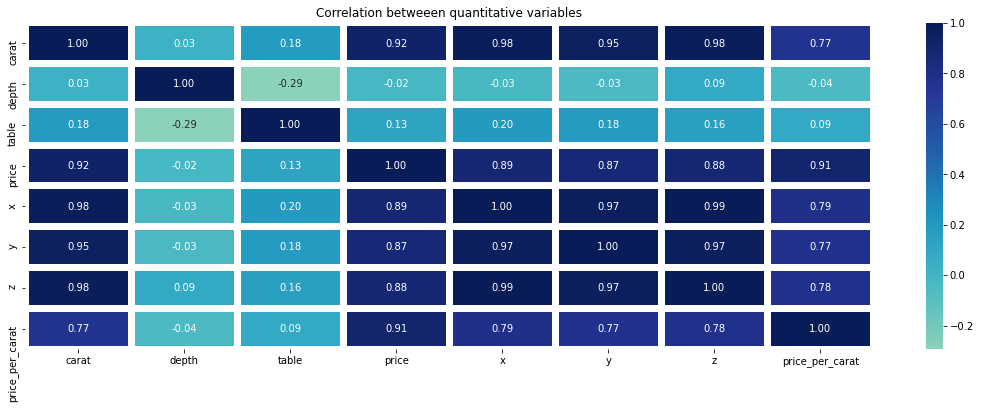

In [56]:
f, ax = plt.subplots(figsize=(19, 6))
sns.heatmap(diamonds.corr(), annot=True,fmt='.2f', linewidths=6, center=0,ax=ax, cmap="YlGnBu").set_title("Correlation betweeen quantitative variables")


### Contingency Table

We can know what is the relation between two categorical table with these contingency tables before measuring the power of this relation.

In [52]:
# tabla de contingencia en porcentajes relativos segun corte
pd.crosstab(index=diamonds['cut'], columns=diamonds['color']
           ).apply(lambda r: r/r.sum() *100,
                                axis=1)

color,D,E,F,G,H,I,J
cut,,,,,,,
Fair,10.478548,13.778878,18.646865,19.141914,18.811881,11.633663,7.508251
Good,13.455741,18.854481,18.141957,17.730885,14.661551,10.660455,6.494930
Ideal,13.271929,18.000865,18.013229,22.408358,14.551524,9.507325,4.246770
Premium,11.258926,16.942189,16.746552,21.500538,17.225863,10.329649,5.996283
Very Good,12.299230,19.966997,18.140814,18.976898,15.126513,9.911991,5.577558


In [ ]:
pd.crosstab(index=diamonds['cut'], columns=diamonds['clarity']).apply(lambda r: r/r.sum() *100,
                                axis=1)

In [ ]:
pd.crosstab(index=diamonds['color'], columns=diamonds['clarity']).apply(lambda r: r/r.sum() *100,
                                axis=1)

## Cramer V

We use cramer V to measure the strenghen of the correlation between two quantitaive variables

In [ ]:
import scipy.stats as ss
import numpy as np
def cramers_v(x, y):
    confusion_matrix = pd.crosstab(x,y)
    chi2 = ss.chi2_contingency(confusion_matrix)[0]
    n = confusion_matrix.sum().sum()
    phi2 = chi2/n
    r,k = confusion_matrix.shape
    phi2corr = max(0, phi2-((k-1)*(r-1))/(n-1))
    rcorr = r-((r-1)**2)/(n-1)
    kcorr = k-((k-1)**2)/(n-1)
    return np.sqrt(phi2corr/min((kcorr-1),(rcorr-1)))

In [ ]:
clarity_vs_cut = cramers_v(diamonds["clarity"],diamonds["cut"])
color_vs_cut = cramers_v(diamonds["color"],diamonds["cut"])
clarity_vs_color = cramers_v(diamonds["clarity"],diamonds["color"])

In [ ]:
print(f'The relation between clarity and cut is:{clarity_vs_cut}.')
print(f'The relation between color and cut is:{color_vs_cut}.')
print(f'The relation between clarity and color is:{clarity_vs_color}.')

All the relations are below 0,3, so it is a weak realtion between variables

## **Conclusions**

After a first analysis, we conclude to delete those events where size of the diamonds was 0. After that, we deleted duplicated data.

**Qualitative variables**

For each variable, we create two plots. The first one gives us an idea about the distribution with the barchar. With the boxplot, we can know more about quartils, median and outlyers. In the second plot, we cross each variable with the "main" variable of this analysis, the price. We can extract these conclusions for the quanlitative variables analyzed:

- Carat has an important influence on prize, as we have expected. The plot trend is positive,so the more carat the more price. 
- It is observed that size(x,y,z) has a relation with price. The curve of the scatter plot seems to be exponential.
- Also, we could observed in the correlation matrix that size is hihg correlated with price. Carat and price per carat are high correlated too. The others correlations trend to zero. No negative correlation were observed. 

**Quantitaive variables**
For each variable, we create four plots. The first one gives us an idea about the distribution with the barchar. With the boxplot, we can know more about quartils, median and outlyers. In the second plot, we cross each variable with the "main" variable of this analysis, the price. For the fourth, we create a piechart where we could know the percentage of each type in the category. We can extract these conclusions for the quantitative variables analyzed:

- The higher grade in the color scale is not related to higher price for this dataset. In adiction, despite de outlyers on each grade, price are more variables in lower grade color scale. 
- For the clarity, similar conclusion was observed. We have more observations on lower clarity scale, so conclusions are similar.
- For the cut factor, ideal cut is the one with more observations, and prices are similar for the entired dataset. We could observed that for cut clasification, price are similar in these dataset. 
- Also, a crosstab were include and Cramer's V. With this comprobation, we could observe the streghten of two quantitative variables. It was observed that all the quantitative variables had a weak relation between them. They do not influence so much in the other ones. 
- For these kind of varibles, we have created a "custom rapaport matrix" where we could estimate the price of a diamond base on this dataset. 


## **Save dataframes**